# Covid Data Analysis

The goal of this project is to first visualize the spread of covid and then use document clustering to group and predict labels for the data.

## Part 1: Time Series Analysis of Covid Cases

In [1]:
!pip install plotly

In [36]:
!pip install pycountry_convert

  Created wheel for pycountry: filename=pycountry-20.7.3-py2.py3-none-any.whl size=10746863 sha256=1ba017728b1e73d2e7d502fcd38983dd2dca7fa2e32a7628d7344934efa23041
  Stored in directory: c:\users\nehel\appdata\local\pip\cache\wheels\09\eb\0d\4ee773c6a4aadc2a43cb5c1d07f268f13c4cdc0eec88e7c1ef
Successfully built pycountry
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


In [38]:
#import data and modules
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt

sns.set(style="white", color_codes=True)
import warnings 
warnings.filterwarnings("ignore")

import plotly as py
import plotly.graph_objects as go
import pandas as pd
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot


import pycountry_convert as pc
import plotly.express as px
import plotly.offline as py

init_notebook_mode(connected=True)

CN


In [3]:
covid_cases = pd.read_csv("data\covid_19_data.csv", parse_dates=['ObservationDate'])

In [4]:
covid_cases.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
0,1,2020-01-22,Anhui,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
1,2,2020-01-22,Beijing,Mainland China,1/22/2020 17:00,14.0,0.0,0.0
2,3,2020-01-22,Chongqing,Mainland China,1/22/2020 17:00,6.0,0.0,0.0
3,4,2020-01-22,Fujian,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
4,5,2020-01-22,Gansu,Mainland China,1/22/2020 17:00,0.0,0.0,0.0


## Data cleaning and visualization


In [5]:
#Check for missing values
covid_cases.isna().sum()

SNo                    0
ObservationDate        0
Province/State     62045
Country/Region         0
Last Update            0
Confirmed              0
Deaths                 0
Recovered              0
dtype: int64

In [6]:
#Look at data types
covid_cases.dtypes

SNo                         int64
ObservationDate    datetime64[ns]
Province/State             object
Country/Region             object
Last Update                object
Confirmed                 float64
Deaths                    float64
Recovered                 float64
dtype: object

In [7]:
print("The first case was reported on {} and the last case avaiable in the dataset is as of {}.".format(covid_cases.ObservationDate.min().strftime("%d-%b-%Y"),covid_cases.ObservationDate.max().strftime("%d-%b-%Y")))

The first case was reported on 22-Jan-2020 and the last case avaiable in the dataset is as of 27-Feb-2021.


In [8]:
# Calcualte active cases
covid_cases['Active'] = covid_cases['Confirmed'] - covid_cases['Deaths'] - covid_cases['Recovered']

In [9]:
#Since there is no meaninful way to fill the missing Proviance/State these are kept as empty string
covid_cases[['Province/State']] = covid_cases[['Province/State']].fillna('')


In [10]:
#Renaming Mainland China to China
covid_cases['Country/Region'] = covid_cases['Country/Region'].replace('Mainland China', 'China')

In [63]:
#group data for plotting
df_dates = covid_cases.groupby(['ObservationDate'])['Confirmed','Recovered','Deaths'].sum()

In [64]:
df_dates

,Confirmed,Recovered,Deaths
ObservationDate,,,
2020-01-22,557.0,30.0,17.0
2020-01-23,1097.0,60.0,34.0
2020-01-24,941.0,39.0,26.0
2020-01-25,1437.0,42.0,42.0
2020-01-26,2118.0,56.0,56.0
...,...,...,...
2021-02-23,112109754.0,63295144.0,2485434.0
2021-02-24,112554301.0,63504603.0,2497488.0
2021-02-25,113001412.0,63732295.0,2507624.0


In [71]:
#plot total cases, recovered and deaths
fig = go.Figure()
fig.add_trace(go.Scatter(
                x=df_dates.index,
                y=df_dates['Confirmed'],
                name="Confirmed",
                line_color='deepskyblue',
                opacity=0.8,
                fill='tozeroy'))

fig.add_trace(go.Scatter(
                 x=df_dates.index,
                 y=df_dates['Recovered'],
                 name="Recovered",
                 line_color='dimgray',
                 opacity=0.8,
                 fill='tozeroy'))

fig.add_trace(go.Scatter(
                 x=df_dates.index,
                 y=df_dates['Deaths'],
                 name="Deaths",
                 line_color='red',
                 opacity=0.8,
                 fill='tozeroy'))

fig.update_layout(title_text='Time Series with Rangeslider',
                   xaxis_rangeslider_visible=True)
#py.offline.plot(fig, filename=r'C:\Users\Nehel\Desktop\MIE1624\Final Project\images\covid_cases.html')
py.offline.iplot(fig)

In [79]:
#plot total cases, recovered and deaths
py.init_notebook_mode(connected=True)

formated_gdf = covid_cases.groupby(['ObservationDate', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered'].max()

formated_gdf = formated_gdf.reset_index()

formated_gdf['Date'] = pd.to_datetime(formated_gdf['ObservationDate'])
formated_gdf['Date'] = formated_gdf['ObservationDate'].dt.strftime('%m/%d/%Y')
formated_gdf['size'] = formated_gdf['Confirmed'].pow(0.3)

fig = px.scatter_geo(formated_gdf, locations="Country/Region", locationmode='country names', 
                     color="Confirmed", size='size', hover_name="Country/Region", 
                     range_color= [0, max(formated_gdf['Confirmed'])+2], 
                     projection="natural earth", animation_frame="Date", 
                     title='Spread of COVID-19')

fig.update(layout_coloraxis_showscale=False)
#py.offline.plot(fig, filename=r'C:\Users\Nehel\Desktop\MIE1624\Final Project\images\covid_spread.html')
py.offline.iplot(fig)

# Part 2: Document Clustering

In [1]:
!pip install langdetect
!pip install tqdm

In [80]:
#import modules
from datetime import date, timedelta

from wordcloud import WordCloud

import re
import string
import nltk
nltk.download("stopwords") 
nltk.download('punkt')
nltk.download('wordnet')

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn import metrics
from sklearn.decomposition import PCA
from scipy.spatial.distance import cdist
from sklearn.model_selection import train_test_split,GridSearchCV


from sklearn.metrics import accuracy_score, f1_score
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.naive_bayes import BernoulliNB
from sklearn.svm import LinearSVC
from sklearn.tree import DecisionTreeClassifier

from langdetect import detect
from langdetect import DetectorFactory
from pprint import pprint

from tqdm import tqdm

from nltk.stem import WordNetLemmatizer 
from emoji.unicode_codes import UNICODE_EMOJI
from nltk.corpus import stopwords  
from nltk.tokenize import word_tokenize

import warnings
warnings.filterwarnings("ignore")

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Nehel\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Nehel\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Nehel\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [81]:
df = pd.read_csv("data\metadata.csv", parse_dates=['publish_time'])

In [82]:
df.head(2)

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,PMC,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,PMC35282,11472636,no-cc,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,NaN,NaN,NaN,document_parses/pdf_json/d1aafb70c066a2068b027...,document_parses/pmc_json/PMC35282.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3...,NaN
1,02tnwd4m,6b0567729c2143a66d737eb0a2f63f2dce2e5a7d,PMC,Nitric oxide: a pro-inflammatory mediator in l...,10.1186/rr14,PMC59543,11667967,no-cc,Inflammatory diseases of the respiratory tract...,2000-08-15,"Vliet, Albert van der; Eiserich, Jason P; Cros...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/6b0567729c2143a66d737...,document_parses/pmc_json/PMC59543.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN


In [5]:
#The dataset contains a number of missing values
df.isna().sum()

cord_uid                 0
sha                 325801
source_x                 0
title                  232
doi                 216153
pmcid               315384
pubmed_id           255970
license                  0
abstract            134842
publish_time           219
authors              13886
journal              33151
mag_id              497906
who_covidence_id    300338
arxiv_id            491219
pdf_json_files      325801
pmc_json_files      358021
url                 195956
s2_id                49001
dtype: int64

In [6]:
#The dataset contains mostly text/string based data
df.dtypes

cord_uid                    object
sha                         object
source_x                    object
title                       object
doi                         object
pmcid                       object
pubmed_id                   object
license                     object
abstract                    object
publish_time        datetime64[ns]
authors                     object
journal                     object
mag_id                     float64
who_covidence_id            object
arxiv_id                    object
pdf_json_files              object
pmc_json_files              object
url                         object
s2_id                      float64
dtype: object

In [7]:
#Since we want to limit our analysis to the current pandemic, lets see how many articles were published before november 2019
df[df['publish_time'] < pd.Timestamp(2019,11,30)].shape[0]

93883

In [8]:
#There are also some articles which have a publish time in the future, these can be removed as well
df[df['publish_time'] > pd.Timestamp(2021,4,1)].shape[0]

355

In [83]:
#This articles can be removed, furthermore unused columns are also removed below
df = df[df['publish_time'] > pd.Timestamp(2019,11,30)]
df = df[df['publish_time'] < pd.Timestamp(2021,4,1)]
df = df[['title','publish_time','abstract','authors','journal','url']]

In [10]:
#The current dataframe now contains over 403,000 articles
df.shape[0]

403286

In [11]:
#Out of these articles, 120,000 have no text for abstract. Since abstract is to be used to carry out classification, the missing valus are removed
df.isna().sum()

title              221
publish_time         0
abstract        120248
authors           9919
journal          31931
url             194733
dtype: int64

In [84]:
#Drop missing and duplicate data
df.dropna(subset=['abstract'],inplace=True)
df.drop_duplicates(['abstract'],inplace=True)

Lets see how the number of published articles changed with time:

In [85]:
df_dates = df.groupby('publish_time').count()['title'].reset_index()

<AxesSubplot:xlabel='publish_time'>

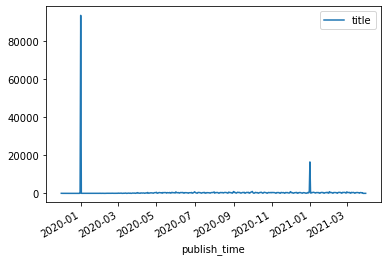

In [17]:
#It is interesting to note that disproportionate amount of new research papers are released on the new years day
df_dates.plot(x="publish_time",y="title")

In [86]:
#To get an idea of the trend of number of new articles, lets remove the new year dates
df_dates = df_dates[(df_dates["publish_time"] !='2020-01-01')&(df_dates["publish_time"] !='2021-01-01')]

In [63]:
df_dates

,publish_time,title
0,2019-12-01,49
1,2019-12-02,16
2,2019-12-03,29
3,2019-12-04,19
4,2019-12-05,32
...,...,...
481,2021-03-26,366
482,2021-03-27,14
483,2021-03-29,32
484,2021-03-30,1


In [122]:
from scipy.signal import lfilter

n = 15  # the larger n is, the smoother curve will be
b = [1.0 / n] * n
a = 1
titles_data = lfilter(b,a,df_dates['title'])

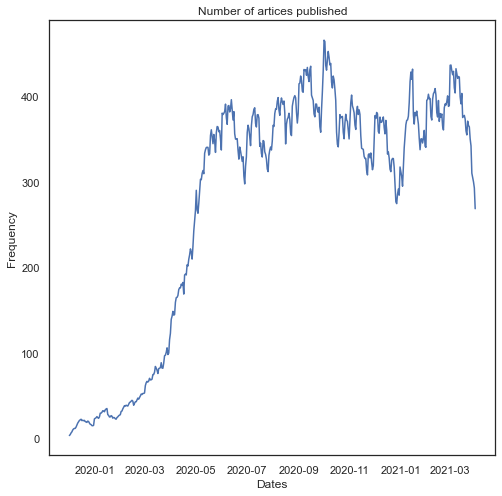

In [125]:
plt.figure(figsize=(8,8))
plt.plot(df_dates['publish_time'],titles_data)
plt.xlabel("Dates")
plt.ylabel("Frequency")
plt.title("Number of artices published")
plt.savefig("images\Articles_published.png")

In [87]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 244511 entries, 4162 to 497905
Data columns (total 6 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   title         244469 non-null  object        
 1   publish_time  244511 non-null  datetime64[ns]
 2   abstract      244511 non-null  object        
 3   authors       242565 non-null  object        
 4   journal       218703 non-null  object        
 5   url           138982 non-null  object        
dtypes: datetime64[ns](1), object(5)
memory usage: 13.1+ MB


## Text Cleaning

In this project a clustering model will be created in order to group similar artices together based on content. In order to group similar artices together, the description from the abstract text of the articles will be used.

Before this is done, cleaning and pre-processing is required on the dataset. 

The following tasks will be perfomed on the dataset for cleaning and pre-processing:

1. Remove all stop words
2. Remove all punctuations
3. Change all text to lower-case
4. Lemmetize test
5. Keep only literature that is in english 

In [88]:
stop_words = set(stopwords.words('english'))
covid_terms = ['covid','study','patient','sarscov','pandemic','virus','covid19','sarscov2','coronavirus','epidemic','patients','igg','paper','health','result','data','care','case','result','using','sars','cov','diseases','disease','ace','review','associated','infection',]


In [89]:
for w in covid_terms:
    if w not in stop_words:
        stop_words.add(w)

In [90]:
#Create a function to carry out text clearning
def clean_data(text):
    
    text = str(text)

    #Remove all only numerical data
    text = re.sub("^\d+\s|\s\d+\s|\s\d+$", "", text)    

    #change all text to lowercase
    text = text.lower()
       
    #delete all hyperlinks and URL's
    text = re.sub('https?://\S+|www\.\S+', '', text)
    
    #Remove all tags
    text = text.translate(str.maketrans('','','/<[^>]+>/'))
    
    #Remove all punctuations
    text = text.translate(str.maketrans('', '', string.punctuation))

    lem=WordNetLemmatizer()
    #Remove all stop-words
    text = [lem.lemmatize(w) for w in word_tokenize(text) if not w in stop_words]
    text = [word for word in text if not word in stop_words]
    return text

In [91]:
#The title might also help in clustering the text, therefore the title and abstract are combined
df['abstract_clean'] = df['title'] + ' ' + df['abstract']

In [92]:
#Clean Text
# Due to the size of the dataset, running a machine learning model would be very computationaly intensive, therefore a subest of 50,000 rows is used
df = df.sample(50000, random_state=42)
df.reset_index(drop=True,inplace = True)

In [93]:
df['abstract_clean'] = df['abstract_clean'].apply(lambda x:clean_data(x))

In [94]:
df['abstract_len'] = df['abstract'].apply(lambda x:len(x))

<AxesSubplot:ylabel='abstract_len'>

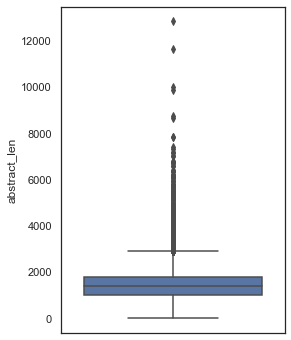

In [120]:
plt.figure(figsize=(4,6))
sns.boxplot(y= df['abstract_len'],orient="v")

Text(0.5, 0, 'Word Count')

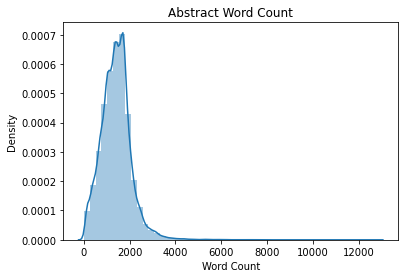

In [26]:
sns.distplot(df['abstract_len'])
plt.title("Abstract Word Count")
plt.xlabel("Word Count")

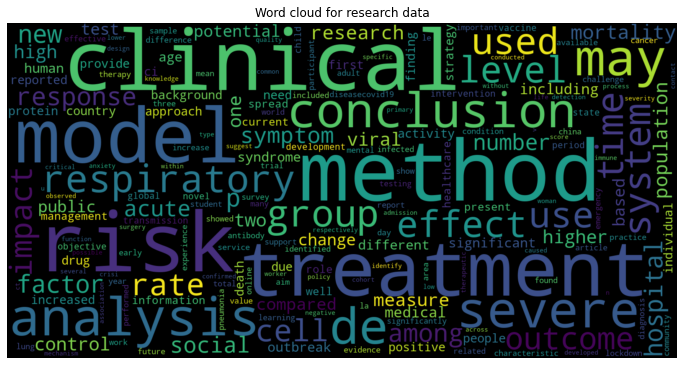

In [27]:
text = df['abstract_clean'].apply(lambda x: ' '.join(x))
text_string = []
for t in text:
    text_string.append(t)
text_string = pd.Series(text_string).str.cat(sep=' ')


wordcloud = WordCloud(collocations=False,width=1600, height=800,max_font_size=200).generate(text_string)
fig, axes = plt.subplots(1, 1, figsize = (12,10))
axes.set_title('Word cloud for research data')
axes.imshow(wordcloud, interpolation="bilinear")
axes.axis("off")

plt.savefig('images\Word_cloud_covid.png')
plt.show()


In [95]:
languages = []
for i in tqdm(range(0,len(df))):
    lang = detect(" ".join(df.iloc[i]['abstract_clean'][0:500]))
    languages.append(lang)

100%|██████████| 50000/50000 [08:25<00:00, 99.01it/s]


In [96]:
languages_dict = {}
for lang in set(languages):
    languages_dict[lang] = languages.count(lang)
    
print("Total: {}\n".format(len(languages)))
pprint(languages_dict)

Total: 50000

{'bg': 1,
 'ca': 8,
 'da': 2,
 'de': 78,
 'en': 48813,
 'es': 441,
 'fr': 208,
 'hr': 2,
 'hu': 6,
 'it': 42,
 'ja': 2,
 'ko': 9,
 'lt': 1,
 'nl': 36,
 'no': 3,
 'pt': 214,
 'ro': 6,
 'ru': 72,
 'sv': 1,
 'tl': 6,
 'tr': 8,
 'vi': 4,
 'zh-cn': 37}


In [99]:
#Almost all the articles are in english, lets visualize the other languages present
languages_dict_sorted = sorted(languages_dict.items(), key=lambda x: x[1],reverse=True)
languages_dict_sorted = dict(languages_dict_sorted)
languages_dict_sorted.pop('en', None)

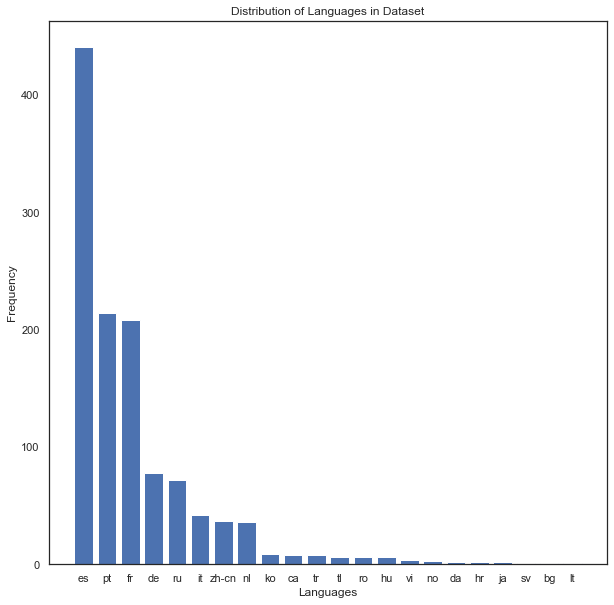

In [118]:
plt.figure(figsize=(10,10))
plt.bar(range(len(languages_dict_sorted)), list(languages_dict_sorted.values()), align='center')
plt.xticks(range(len(languages_dict_sorted)), list(languages_dict_sorted.keys()))
plt.title("Distribution of Languages in Dataset")
plt.xlabel("Languages")
plt.ylabel("Frequency")
plt.savefig("images\Language_distribution.png")
plt.show()

While the majority of the artices are in english, spanish, french and portugeese are also common languages. 

For simplicity, these languages are removed and only english text is considered. 

In [102]:
df['languages'] = languages
df =df[df['languages'] == 'en'] 
df.head()

,title,publish_time,abstract,authors,journal,url,abstract_clean,abstract_len,languages
0,Chronic diseases: An added burden to income an...,2020-01-01,"In the global context, health and the quality ...","Jayathilaka, Ruwan; Joachim, Sheron; Mallikara...",PLoS One,NaN,"[chronic, added, burden, income, expense, chro...",2294,en
1,Web App Design for Surface Plasmon Resonance S...,2020-01-01,The rapid spread of COVID-19 disturbs the avai...,"Anshori, I.; Baleno Rama, M.; Ezra, R.; Harimu...","Proceeding - Int. Conf. Radar, Antenna, Microw...",NaN,"[web, app, design, surface, plasmon, resonance...",1348,en
2,Tele-Medicine Services in Hematological Practi...,2020-11-20,"In COVID 19 pandemic, delivery and access of h...","Kumar, Pradeep; Aggarwal, Mukul; Dhawan, Rishi...",Indian J Hematol Blood Transfus,https://doi.org/10.1007/s12288-020-01385-7; ht...,"[telemedicine, service, hematological, practic...",1722,en
4,Point-of-care CRISPR/Cas nucleic acid detectio...,2020-01-01,With the trend of moving molecular tests from ...,"van Dongen, Jeanne E; Berendsen, Johanna T W; ...",Biosens Bioelectron,NaN,"[pointofcare, crisprcas, nucleic, acid, detect...",1130,en
5,Racial disparities in COVID-19 hospitalization...,2020-01-01,OBJECTIVES: The objective of the study is the ...,"Krishnamoorthy, G; Arsene, C; Jena, N; Mogulla...",Public Health,NaN,"[racial, disparity, hospitalization, lead, dis...",1813,en


We can now proceed to vectorizing the data and training a K-means model. Since the model will be trained on the vectorized text data, the model will have features equal to the overall vocabulary of the corpus. Due to this big vocabulary, it is best to conduct PCA to limit the number of features. We will be only keeping features that explain 95% of the variance of the dataset.

## Vectorize Data

In [103]:
vectorizer = TfidfVectorizer(max_features=3000)
X = vectorizer.fit_transform(df['abstract_clean'].apply(lambda x: ' '.join(x)))

In [104]:
X.shape

(48813, 3000)

## Conduct Dimensionality Reduction


In [106]:
#Using PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=0.95,random_state=42)
X_reduced = pca.fit_transform(X.toarray())
X_reduced.shape

(48813, 2402)

In [107]:
svd = TruncatedSVD(n_components=2400, n_iter=7,random_state=42)
X_reduced_svd = svd.fit_transform(X)
print(svd.explained_variance_ratio_.sum())

0.9490052157589658


## K-Means Clustering

In [37]:
# run kmeans with many different k for svd
distortions = []

for k in tqdm(range(5, 25)):
    k_means = KMeans(n_clusters=k, random_state=42).fit(X_reduced_svd)
    k_means.fit(X_reduced_svd) 
    distortions.append(sum(np.min(cdist(X_reduced_svd, k_means.cluster_centers_, 'euclidean'), axis=1)) / X.shape[0])

100%|██████████| 20/20 [1:13:23<00:00, 220.17s/it]


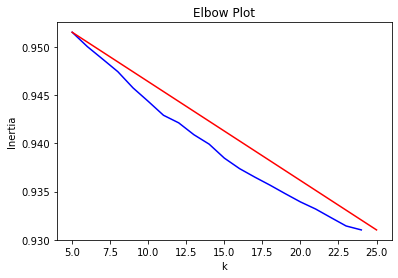

In [39]:
X_line = [5, 25]
Y_line = [distortions[0], distortions[-1]]

# Plot the elbow
plt.plot(range(5,25), distortions, 'b-')
plt.plot(X_line, Y_line, 'r')
plt.xlabel('k')
plt.ylabel('Inertia')
plt.title('Elbow Plot')
plt.show()

In [108]:
k = 15
kmeans = KMeans(n_clusters=k, random_state=42)
y_pred_svd = kmeans.fit_predict(X_reduced_svd)

df['y_svd'] = y_pred_svd

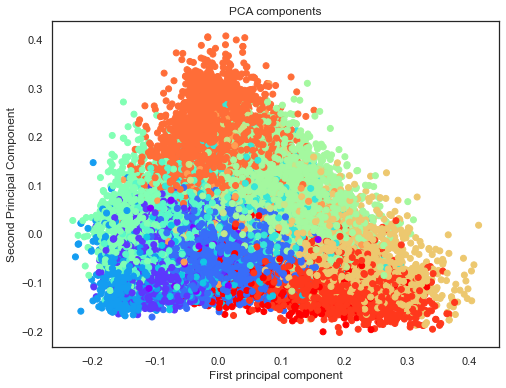

In [117]:
#Plot principal components
plt.figure(figsize=(8,6))
plt.scatter(X_reduced[:,0],X_reduced[:,1],c=y_pred_svd,cmap='rainbow')
plt.xlabel('First principal component')
plt.ylabel('Second Principal Component')
plt.title("PCA components")
plt.savefig("images/PCA_components.png")

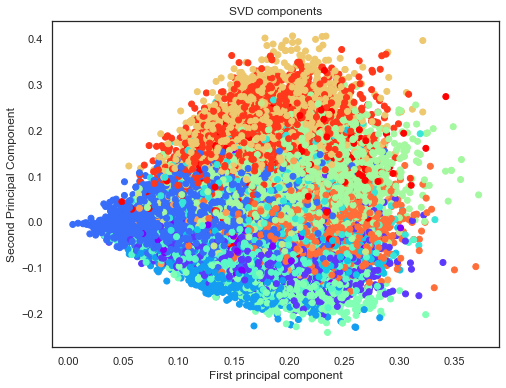

In [116]:
#Plot SVD components
plt.figure(figsize=(8,6))
plt.scatter(X_reduced_svd[:,0],X_reduced_svd[:,1],c=y_pred_svd,cmap='rainbow')
plt.xlabel('First principal component')
plt.ylabel('Second Principal Component')
plt.title("SVD components")
plt.savefig("images/SVD_components.png")

In [41]:
tsne = TSNE(verbose=1, perplexity=100, random_state=42)
X_embedded_svd = tsne.fit_transform(X_reduced_svd)

[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 48812 samples in 0.125s...
[t-SNE] Computed neighbors for 48812 samples in 185.007s...
[t-SNE] Computed conditional probabilities for sample 1000 / 48812
[t-SNE] Computed conditional probabilities for sample 2000 / 48812
[t-SNE] Computed conditional probabilities for sample 3000 / 48812
[t-SNE] Computed conditional probabilities for sample 4000 / 48812
[t-SNE] Computed conditional probabilities for sample 5000 / 48812
[t-SNE] Computed conditional probabilities for sample 6000 / 48812
[t-SNE] Computed conditional probabilities for sample 7000 / 48812
[t-SNE] Computed conditional probabilities for sample 8000 / 48812
[t-SNE] Computed conditional probabilities for sample 9000 / 48812
[t-SNE] Computed conditional probabilities for sample 10000 / 48812
[t-SNE] Computed conditional probabilities for sample 11000 / 48812
[t-SNE] Computed conditional probabilities for sample 12000 / 48812
[t-SNE] Computed conditional probabilities for 

C:\Users\Nehel\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


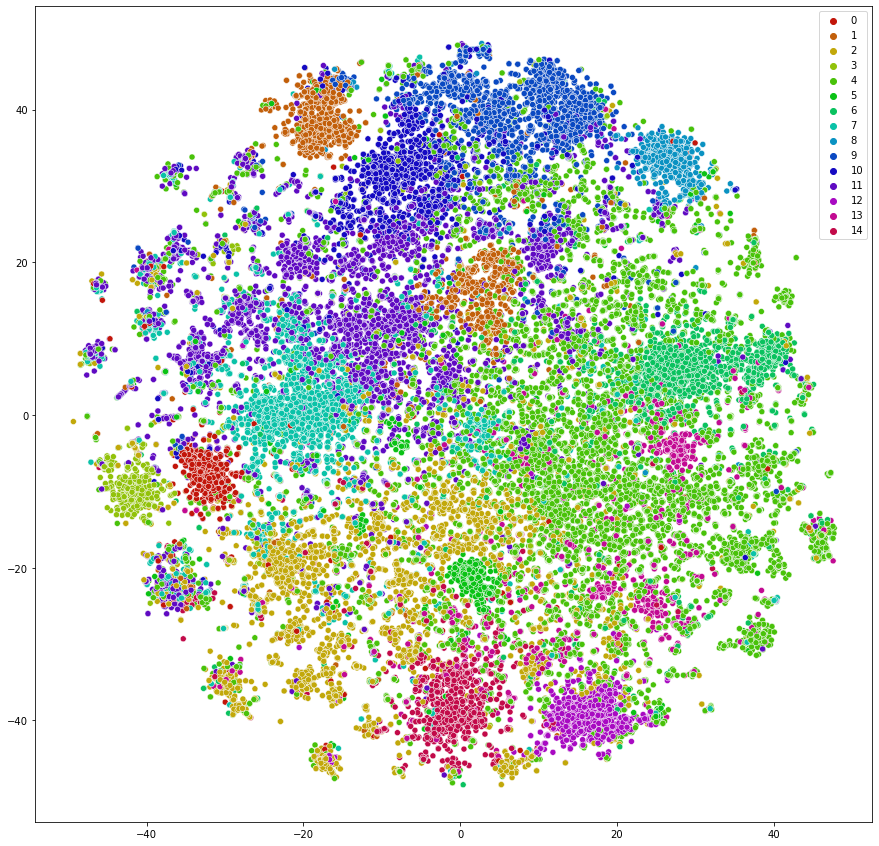

<Figure size 432x288 with 0 Axes>

In [44]:
plt.figure(figsize=(15,15))

palette = sns.hls_palette(15, l=.4, s=.9)

sns.scatterplot(x= X_embedded_svd[:,0],y = X_embedded_svd[:,1], hue=y_pred_svd, legend='full', palette=palette)


plt.show()
plt.savefig('clustered_svd.png')

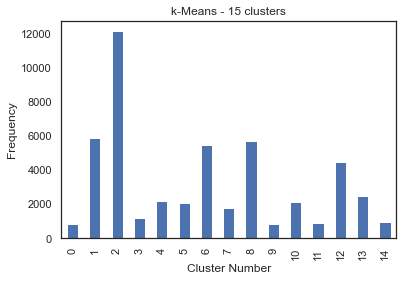

In [115]:
df['y_svd'].value_counts(sort=False).plot(kind="bar")
plt.xlabel("Cluster Number")
plt.ylabel("Frequency")
plt.title("k-Means - 15 clusters")
plt.savefig("images/k_means_clustering.png")

In [45]:
vectorizers = []

for ii in range(0, 15):
    # Creating a vectorizer
    vectorizers.append(CountVectorizer(min_df=5, max_df=0.9, stop_words='english', lowercase=True, token_pattern='[a-zA-Z\-][a-zA-Z\-]{2,}'))

vectorized_data = []

for current_cluster, cvec in enumerate(vectorizers):
    vectorized_data.append(cvec.fit_transform(df.loc[df['y_svd'] == current_cluster, 'abstract_clean'].apply(lambda x: ' '.join(x))))

In [47]:
NUM_TOPICS_PER_CLUSTER = 1

lda_models = []
for ii in range(0, 15):
    # Latent Dirichlet Allocation Model
    lda = LatentDirichletAllocation(n_components=NUM_TOPICS_PER_CLUSTER, max_iter=10, learning_method='online',verbose=False, random_state=42)
    lda_models.append(lda)
    
lda_models[0]

LatentDirichletAllocation(learning_method='online', n_components=1,
                          random_state=42, verbose=False)

In [48]:
clusters_lda_data = []

for current_cluster, lda in enumerate(lda_models):
    # print("Current Cluster: " + str(current_cluster))
    
    if vectorized_data[current_cluster] != None:
        clusters_lda_data.append((lda.fit_transform(vectorized_data[current_cluster])))

In [49]:
def selected_topics(model, vectorizer, top_n=5):
    current_words = []
    keywords = []
    
    for idx, topic in enumerate(model.components_):
        words = [(vectorizer.get_feature_names()[i], topic[i]) for i in topic.argsort()[:-top_n - 1:-1]]
        for word in words:
            if word[0] not in current_words:
                keywords.append(word)
                current_words.append(word[0])
                
    keywords.sort(key = lambda x: x[1])  
    keywords.reverse()
    return_values = []
    for ii in keywords:
        return_values.append(ii[0])
    return return_values

In [50]:
all_keywords = []
for current_vectorizer, lda in enumerate(lda_models):
    # print("Current Cluster: " + str(current_vectorizer))

    if vectorized_data[current_vectorizer] != None:
        all_keywords.append(selected_topics(lda, vectorizers[current_vectorizer]))

In [51]:
all_keywords


[['cov', 'sars', 'severe', 'clinical', 'risk'],
 ['test', 'antibody', 'sample', 'testing', 'assay'],
 ['hospital', 'healthcare', 'practice', 'service', 'method'],
 ['treatment', 'risk', 'breast', 'lung', 'outcome'],
 ['analysis', 'research', 'method', 'effect', 'country'],
 ['clinical', 'pediatric', 'parent', 'respiratory', 'severe'],
 ['method', 'number', 'learning', 'based', 'used'],
 ['mortality', 'risk', 'group', 'outcome', 'clinical'],
 ['vaccination', 'development', 'response', 'influenza', 'trial'],
 ['drug', 'protein', 'viral', 'binding', 'antiviral'],
 ['expression', 'immune', 'response', 'gene', 'viral'],
 ['respiratory', 'severe', 'clinical', 'treatment', 'acute'],
 ['learning', 'online', 'education', 'medical', 'teaching'],
 ['distancing', 'measure', 'medium', 'public', 'people'],
 ['mental', 'anxiety', 'psychological', 'depression', 'stress']]

## Model Training

In [39]:
#The labelled data can now be used to train a supervised learning model
#This will help predict the cluster of data in the future articles and classify them

X_train, X_test, y_train, y_test = train_test_split(X_reduced_svd,y_pred_svd, test_size=0.2, random_state=42)

### Logistic Regression

In [45]:
np.logspace(-3,0,10)

array([0.001     , 0.00215443, 0.00464159, 0.01      , 0.02154435,
       0.04641589, 0.1       , 0.21544347, 0.46415888, 1.        ])

In [46]:
grid={"C":np.logspace(-3,0,5), "penalty":["l1","l2"]}
model = LogisticRegression(max_iter=1000,random_state=42)

model_cv = GridSearchCV(model,grid,cv=5)

model_cv.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=LogisticRegression(max_iter=1000, random_state=42),
             param_grid={'C': array([0.001     , 0.00562341, 0.03162278, 0.17782794, 1.        ]),
                         'penalty': ['l1', 'l2']})

In [47]:
print("tuned hpyerparameters :(best parameters) ",model_cv.best_params_)
print("accuracy :",model_cv.best_score_)

tuned hpyerparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
accuracy : 0.9341373659491662


In [48]:
model = LogisticRegression(penalty="l2",C=1,random_state=42, max_iter=1000)
model.fit(X_train,y_train)

LogisticRegression(C=1, max_iter=1000, random_state=42)

In [49]:
y_pred = model.predict(X_test)
y_pred_train = model.predict(X_train)
print("Accuracy score on train set is: {}".format(accuracy_score(y_train,y_pred_train)))
print("Accuracy score for test set is: {}".format(accuracy_score(y_test,y_pred)))

print("F1 score for logistic regression model is: {}".format(f1_score(y_test,y_pred,average='weighted')))

Accuracy score on train set is: 0.9766971396379094
Accuracy score for test set is: 0.9398750384103247
F1 score for logistic regression model is: 0.9397723024451122


### SVM

In [50]:
grid={"C":np.logspace(-3,0,5), "penalty":["l1","l2"]}
clf = LinearSVC(random_state=42, tol=1e-5,max_iter=5000,multi_class="crammer_singer")

clf_cv = GridSearchCV(clf,grid,cv=5)

clf_cv.fit(X_train,y_train)

In [ ]:
print("tuned hpyerparameters :(best parameters) ",clf_cv.best_params_)
print("accuracy :",clf_cv.best_score_)

In [40]:
clf = LinearSVC(random_state=42)
clf.fit(X_train,y_train)

LinearSVC(random_state=42)

In [41]:
y_pred = clf.predict(X_test)
y_pred_train = clf.predict(X_train)
print("Accuracy score on train set is: {}".format(accuracy_score(y_train,y_pred_train)))
print("Accuracy score for test set is: {}".format(accuracy_score(y_test,y_pred)))

print("F1 score for logistic regression model is: {}".format(f1_score(y_test,y_pred,average='weighted')))

Accuracy score on train set is: 0.982663696192159
Accuracy score for test set is: 0.9237939158045683
F1 score for logistic regression model is: 0.9237783532058106


### Naive Bayes

In [ ]:
grid={'alpha':np.linspace(0.01,1,100)}
gnb = BernoulliNB()
gnb_cv = GridSearchCV(gnb,grid,cv=5)
gnb_cv.fit(X_train,y_train)

In [ ]:
print("tuned hpyerparameters :(best parameters) ",gnb_cv.best_params_)
print("accuracy :",gnb_cv.best_score_)

In [43]:
gnb = BernoulliNB()
gnb.fit(X_train,y_train)


BernoulliNB()

In [45]:
y_pred = gnb.predict(X_test)
y_pred_train = gnb.predict(X_train)
print("Accuracy score on train set is: {}".format(accuracy_score(y_train,y_pred_train)))
print("Accuracy score for test set is: {}".format(accuracy_score(y_test,y_pred)))

print("F1 score for logistic regression model is: {}".format(f1_score(y_test,y_pred,average='weighted')))

Accuracy score on train set is: 0.8304524852116463
Accuracy score for test set is: 0.781214790535696
F1 score for logistic regression model is: 0.780405077721764


## Decison Tree

In [50]:
clf = DecisionTreeClassifier(random_state=0,max_depth=10)
clf.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=10, random_state=0)

In [51]:
y_pred = clf.predict(X_test)
y_pred_train = clf.predict(X_train)
print("Accuracy score on train set is: {}".format(accuracy_score(y_train,y_pred_train)))
print("Accuracy score for test set is: {}".format(accuracy_score(y_test,y_pred)))

print("F1 score for logistic regression model is: {}".format(f1_score(y_test,y_pred,average='weighted')))

Accuracy score on train set is: 0.8728329620240198
Accuracy score for test set is: 0.8190105500358497
F1 score for logistic regression model is: 0.8184452686081408
